In [ ]:
import torch
from transformers import CLIPTextModel, CLIPTokenizer
from transformers import logging
from diffusers import AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler
from tqdm.auto import tqdm
from torch import autocast
from PIL import Image
from matplotlib import pyplot as plt
import numpy
from torchvision import transforms as tfms

# For video display:
from IPython.display import HTML
from base64 import b64encode

# Supress some unnecessary warnings when loading the CLIPTextModel
logging.set_verbosity_error()

# Set device
torch_device = 2 if torch.cuda.is_available() else "cpu"

In [ ]:
from mytools import tools as mt

In [ ]:
# Load the autoencoder model which will be used to decode the latents into image space. 
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae")

In [ ]:
# Load the tokenizer and text encoder to tokenize and encode the text. 
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14")

In [ ]:
# The UNet model for generating the latents.
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet")

In [ ]:
# The noise scheduler
scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000)

# To the GPU we go!
vae = vae.to(torch_device)
text_encoder = text_encoder.to(torch_device)
unet = unet.to(torch_device);

In [ ]:
# Settings (same as before except for the new prompt)
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
num_inference_steps = 53            # Number of denoising steps
guidance_scale = 7                  # Scale for classifier-free guidance
generator = torch.manual_seed(38)   # Seed generator to create the inital latent noise
batch_size = 1

In [ ]:
def text2vector(prompt):
    text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]

    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0] 
    return torch.cat([uncond_embeddings, text_embeddings])

In [ ]:
def emb_to_img(text_embeddings,latents=False,start_step = 0):
   
    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    if type(latents)==bool:
    # Prep latents
        latents = torch.randn(
          (batch_size, unet.in_channels, height // 8, width // 8),
          generator=generator,
        )
        latents = latents.to(torch_device)
        latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]
        latents = latents * scheduler.init_noise_sigma
        
        start_step = 1

    else:
        pass
        
        
    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            if i > start_step:
                # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.
                latent_model_input = torch.cat([latents] * 2)
                sigma = scheduler.sigmas[i]
                # Scale the latents (preconditioning):
                # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
                latent_model_input = scheduler.scale_model_input(latent_model_input, t)

                # predict the noise residual
                with torch.no_grad():
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

                # perform guidance
                noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
                noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

                # compute the previous noisy sample x_t -> x_t-1
                # latents = scheduler.step(noise_pred, i, latents)["prev_sample"] # Diffusers 0.3 and below
                latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    images = (image * 255).round().astype("uint8")
    pil_images = [Image.fromarray(image) for image in images]
    return pil_images[0]

In [ ]:
def pil_to_latent(input_im):
    # Single image -> single latent in a batch (so size 1, 4, 64, 64)
    with torch.no_grad():
        latent = vae.encode(tfms.ToTensor()(input_im).unsqueeze(0).to(torch_device)*2-1) # Note scaling
    return 0.18215 * latent.latent_dist.sample()

def latents_to_pil(latents):
    # bath of latents -> list of images
    latents = (1 / 0.18215) * latents
    with torch.no_grad():
        image = vae.decode(latents).sample
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    images = (image * 255).round().astype("uint8")
    pil_images = [Image.fromarray(image) for image in images]
    return pil_images

In [ ]:
start = text2vector("in the mountains at night full of stars 4k")
end   = text2vector("in the mountains in the morning 4k")

0it [00:00, ?it/s]

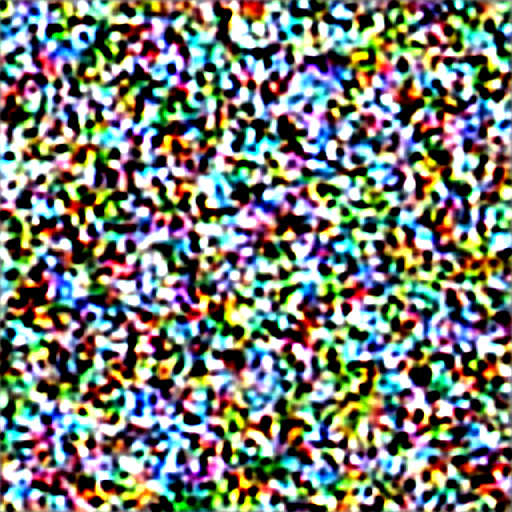

In [ ]:
emb_to_img(start)

0it [00:00, ?it/s]

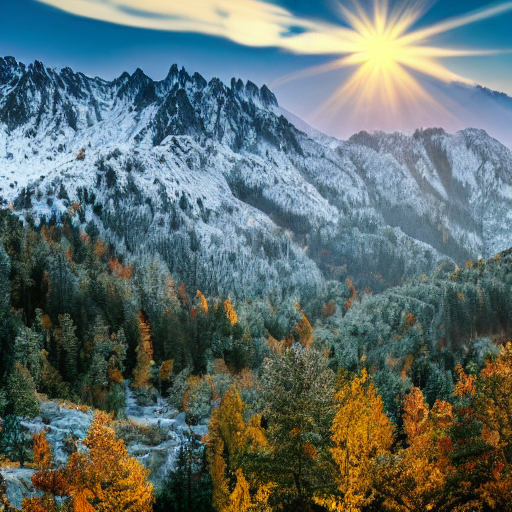

In [ ]:
emb_to_img(end)

In [ ]:
schene = text2vector("in the mountains. night full of stars")
start_context = text2vector("far away")
end_context = text2vector("close up")

In [ ]:
factor = 1

In [ ]:
start = (schene+start_context*factor)/(1+factor)
end = (schene+end_context*factor)/(1+factor)

0it [00:00, ?it/s]

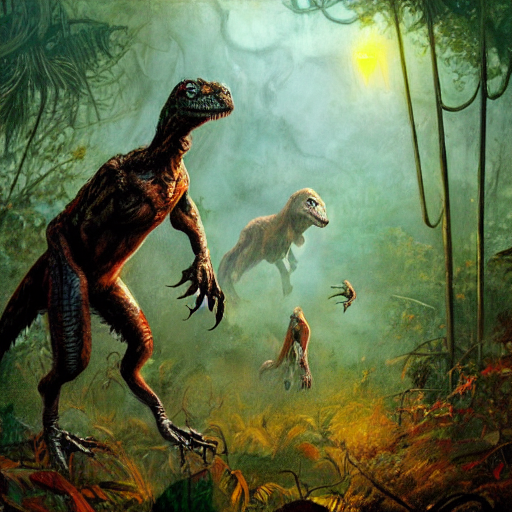

In [ ]:
emb_to_img(schene)

0it [00:00, ?it/s]

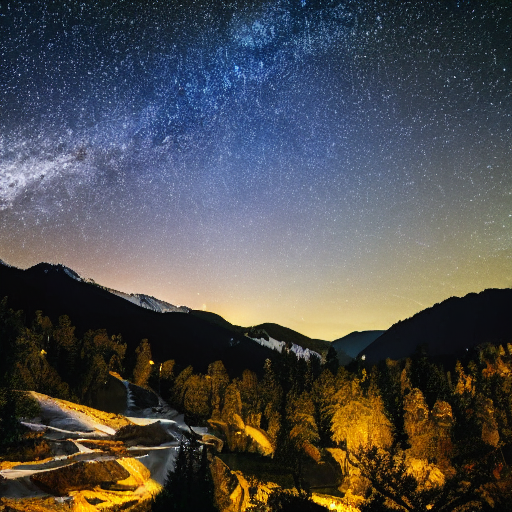

In [ ]:
emb_to_img(start)

0it [00:00, ?it/s]

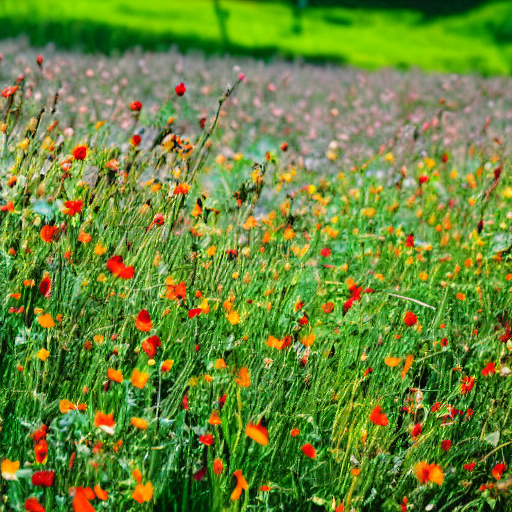

In [ ]:
emb_to_img(end)

In [ ]:
from IPython.display import display

In [ ]:
n = 60

weights = torch.linspace(0,1,n)
weights = weights.to(torch_device)

shots = [torch.lerp(start, end, w) for w in weights]

0it [00:00, ?it/s]

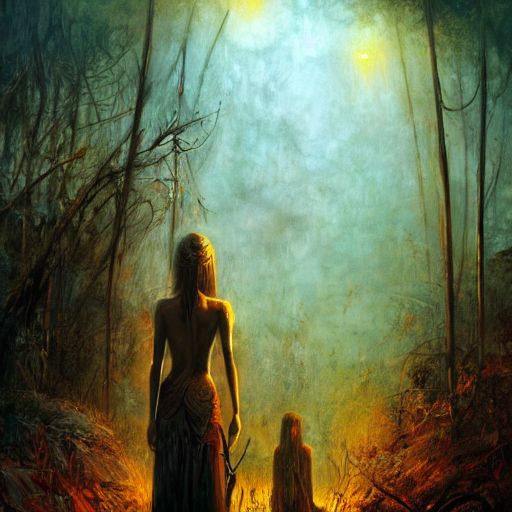

0it [00:00, ?it/s]

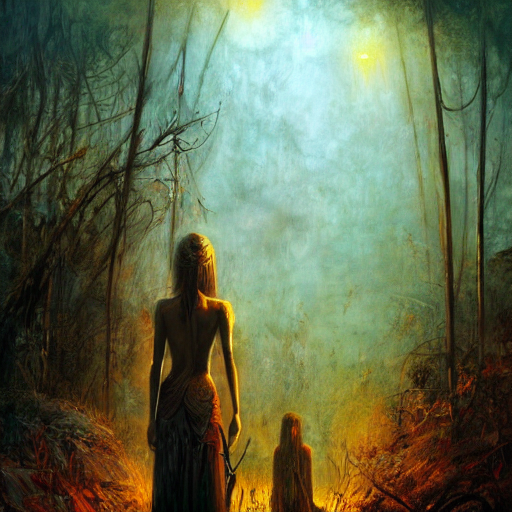

0it [00:00, ?it/s]

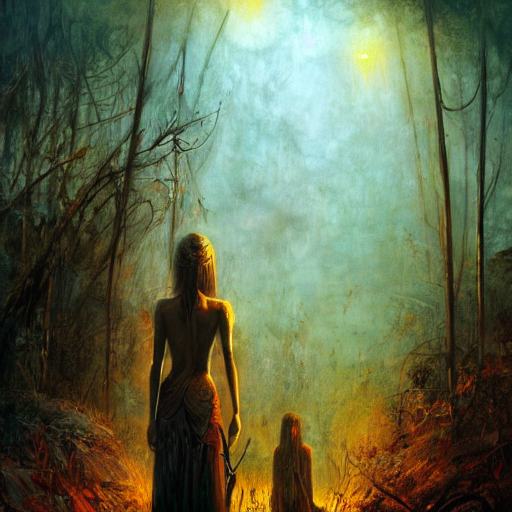

0it [00:00, ?it/s]

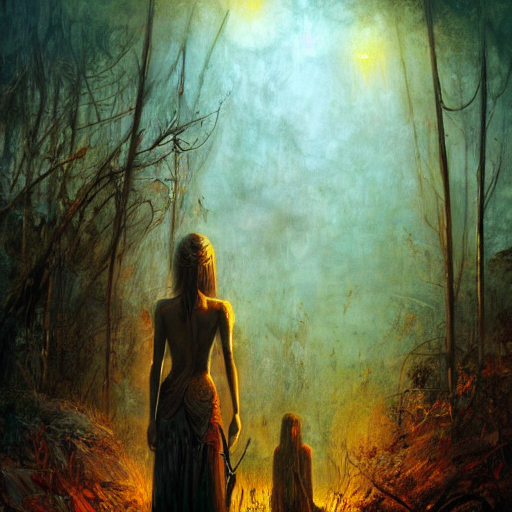

0it [00:00, ?it/s]

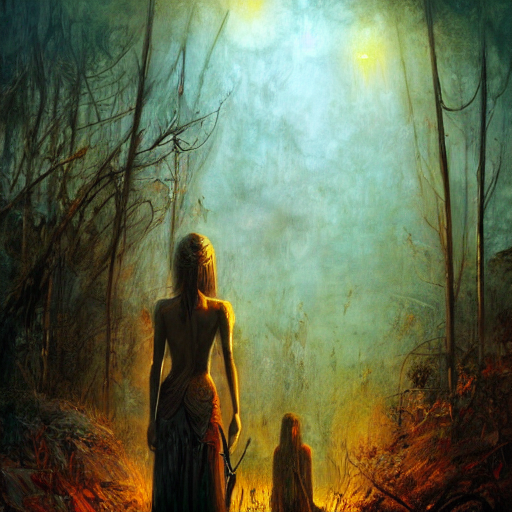

0it [00:00, ?it/s]

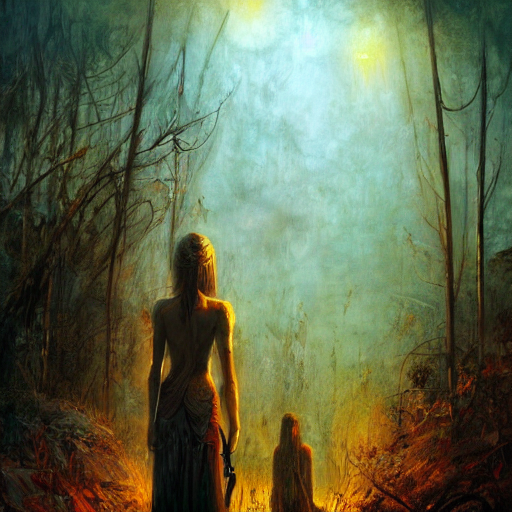

0it [00:00, ?it/s]

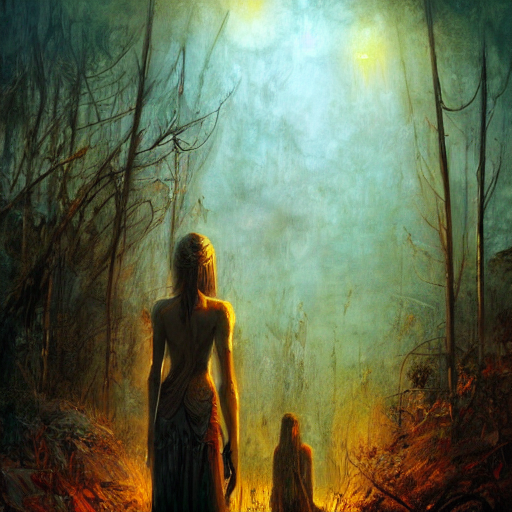

0it [00:00, ?it/s]

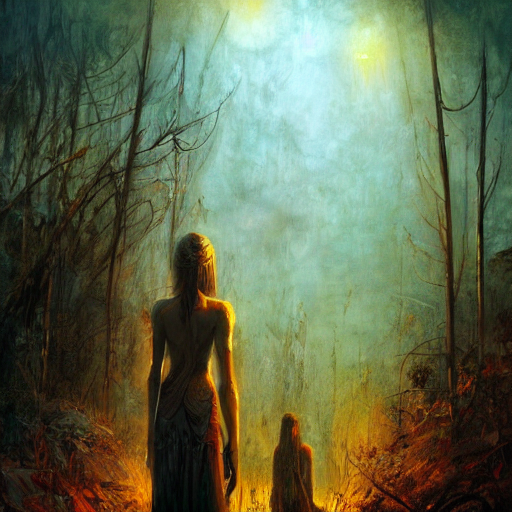

0it [00:00, ?it/s]

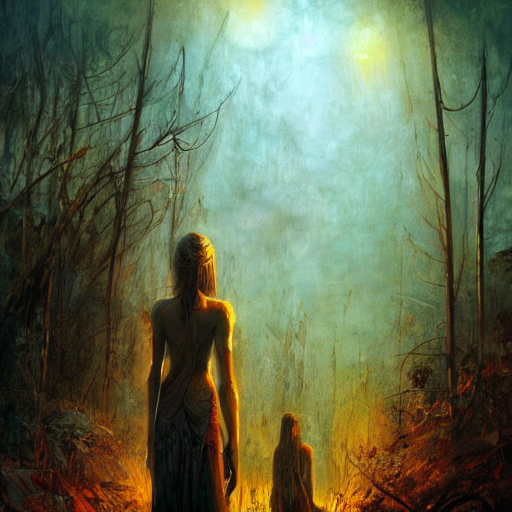

0it [00:00, ?it/s]

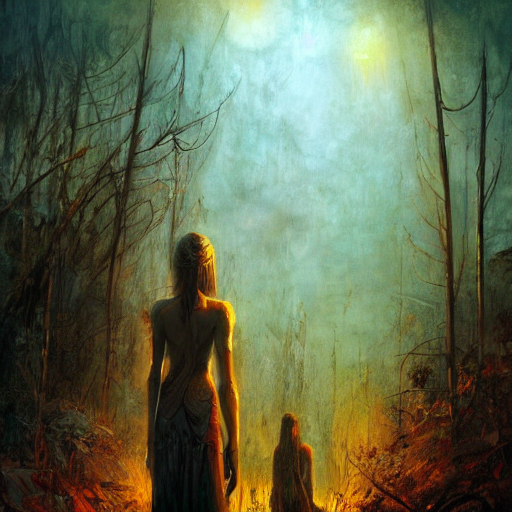

0it [00:00, ?it/s]

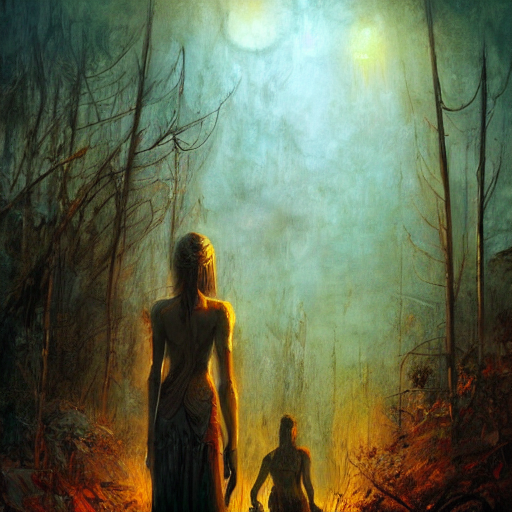

0it [00:00, ?it/s]

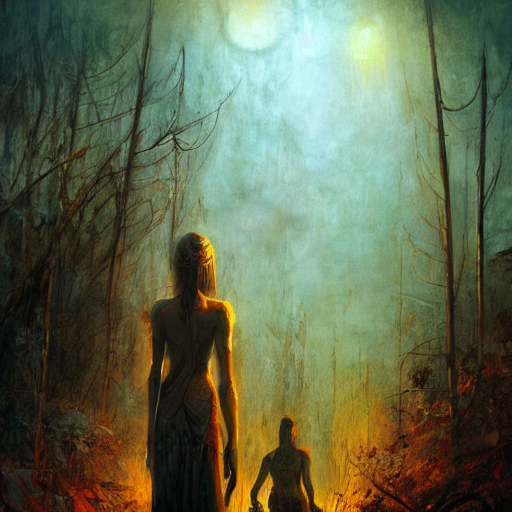

0it [00:00, ?it/s]

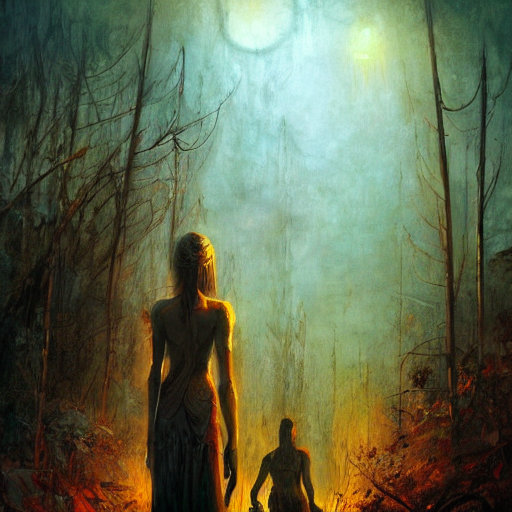

0it [00:00, ?it/s]

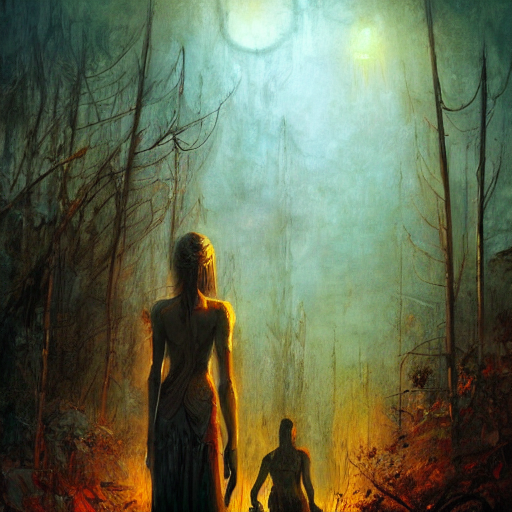

0it [00:00, ?it/s]

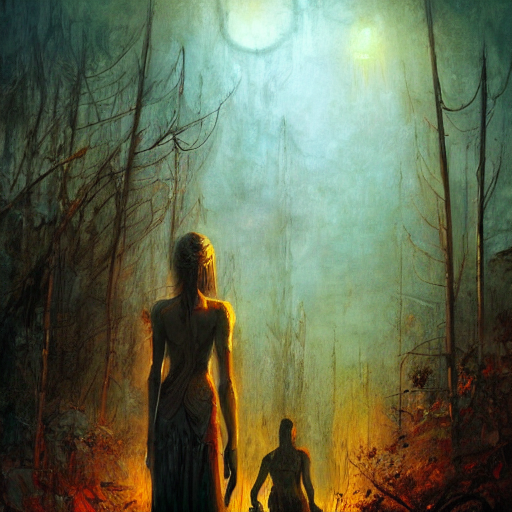

0it [00:00, ?it/s]

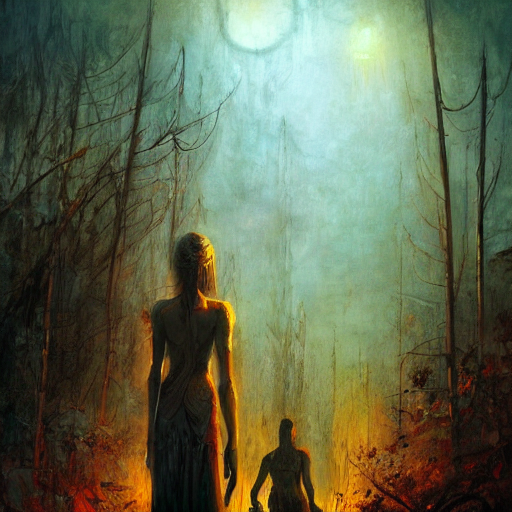

0it [00:00, ?it/s]

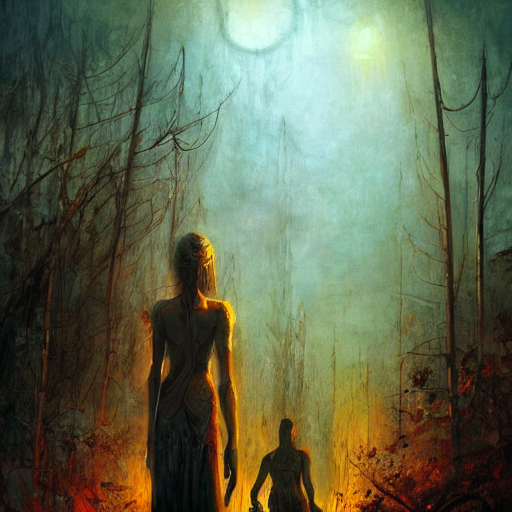

0it [00:00, ?it/s]

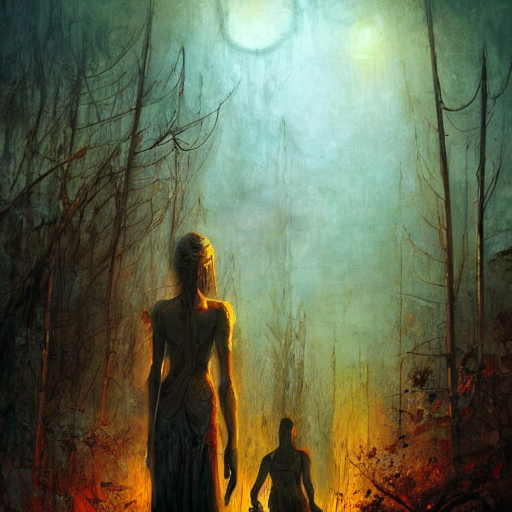

0it [00:00, ?it/s]

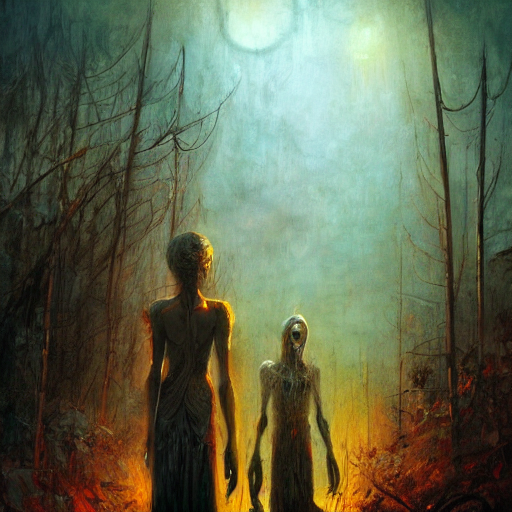

0it [00:00, ?it/s]

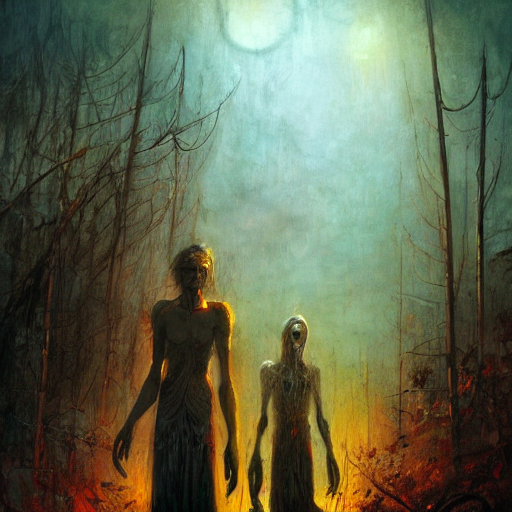

0it [00:00, ?it/s]

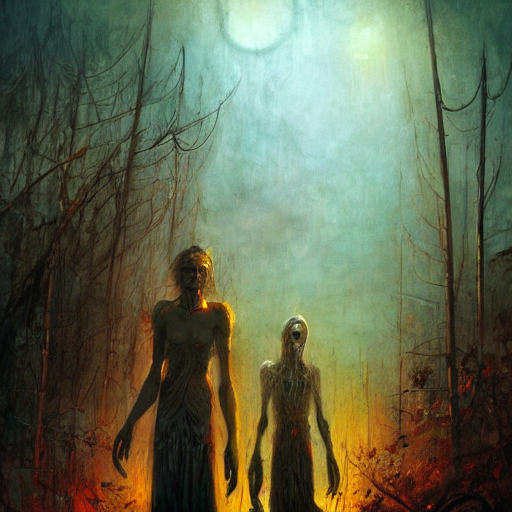

0it [00:00, ?it/s]

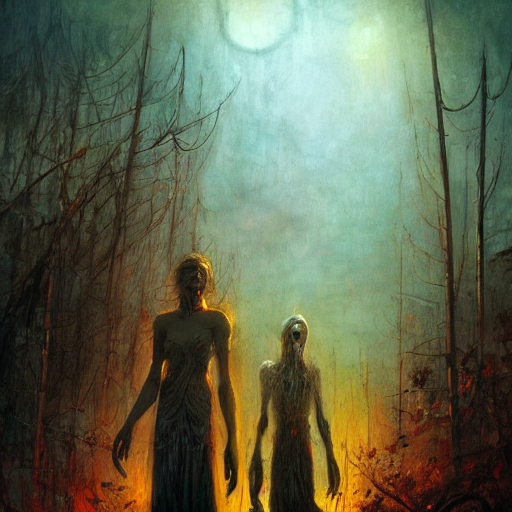

0it [00:00, ?it/s]

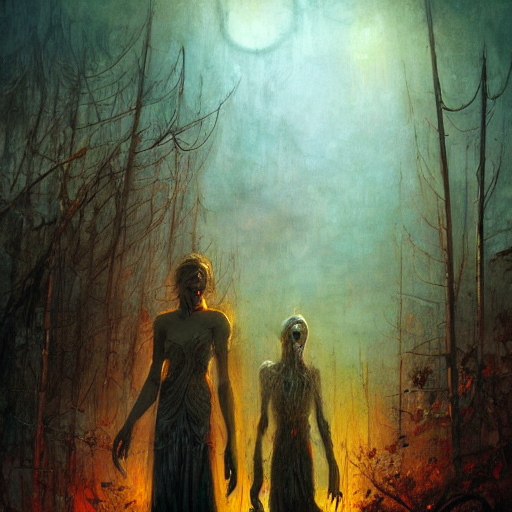

0it [00:00, ?it/s]

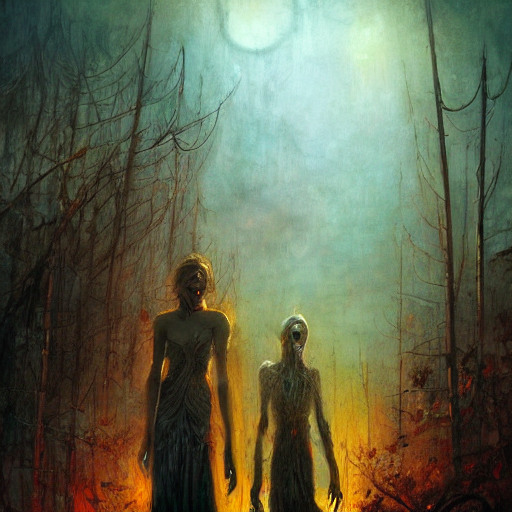

0it [00:00, ?it/s]

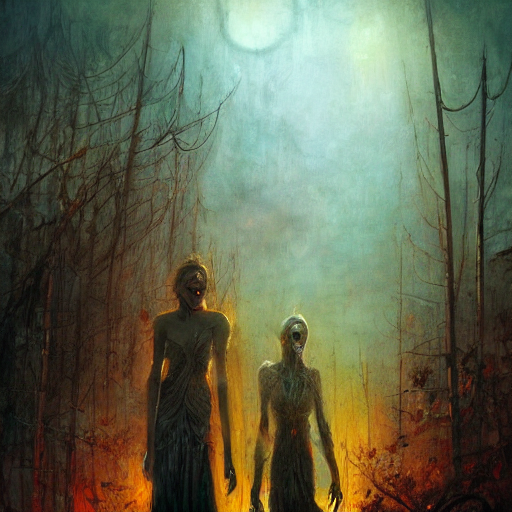

0it [00:00, ?it/s]

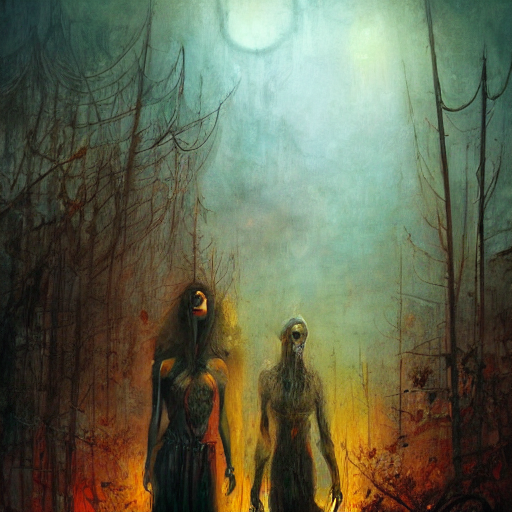

0it [00:00, ?it/s]

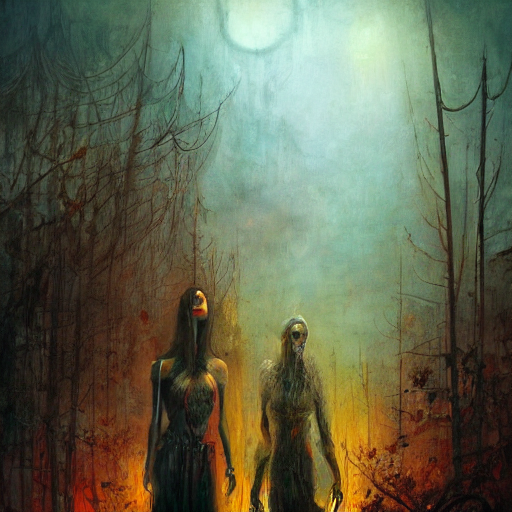

0it [00:00, ?it/s]

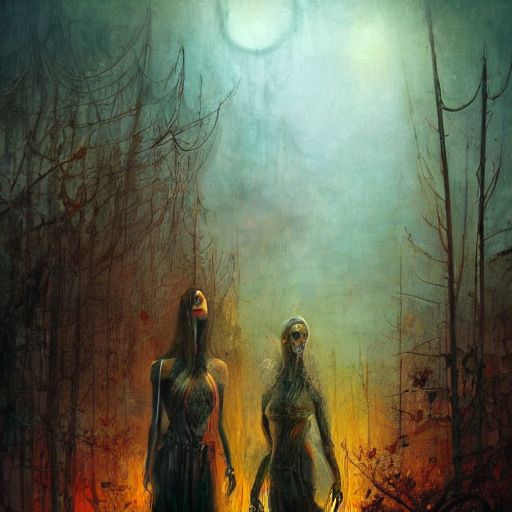

0it [00:00, ?it/s]

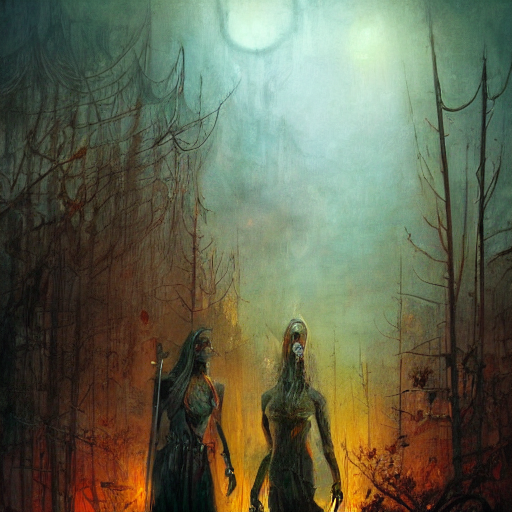

0it [00:00, ?it/s]

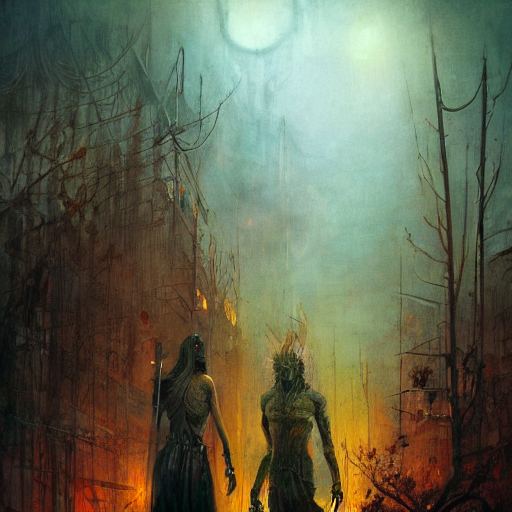

0it [00:00, ?it/s]

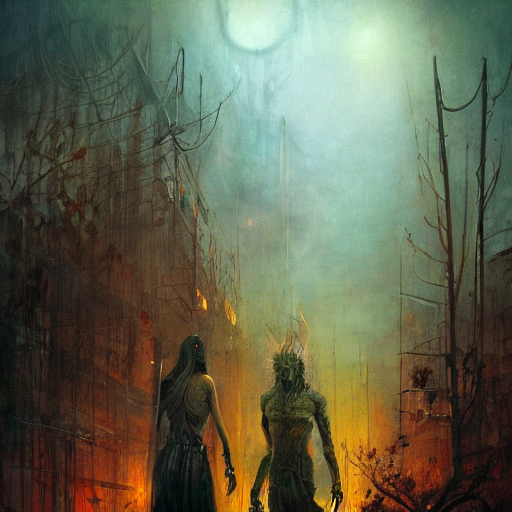

0it [00:00, ?it/s]

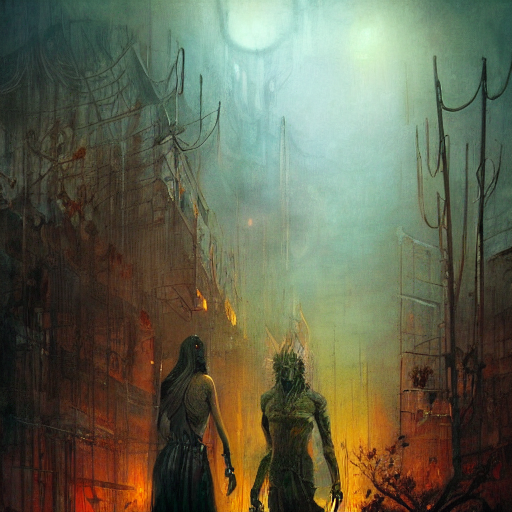

0it [00:00, ?it/s]

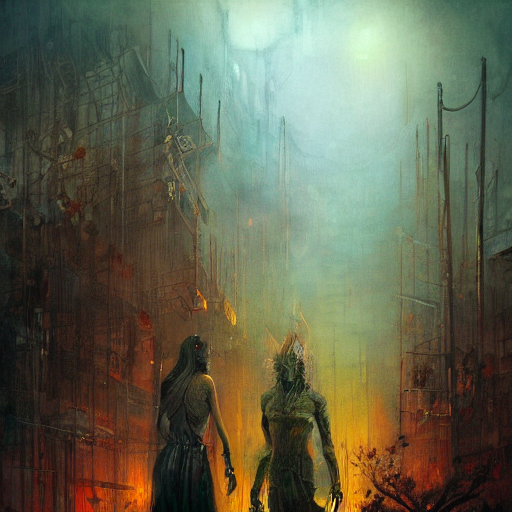

0it [00:00, ?it/s]

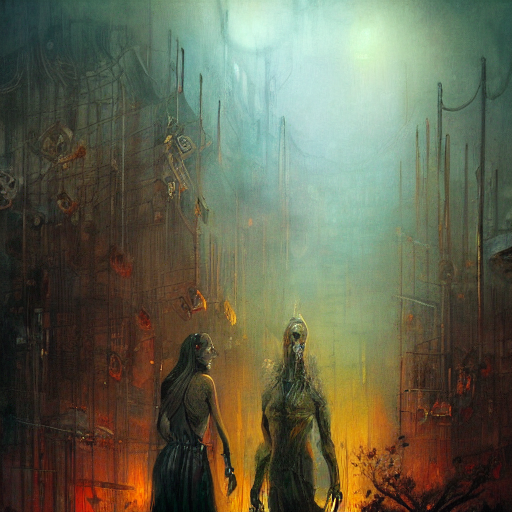

0it [00:00, ?it/s]

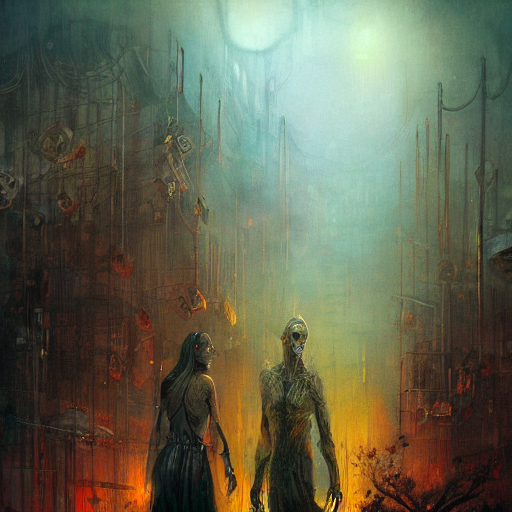

0it [00:00, ?it/s]

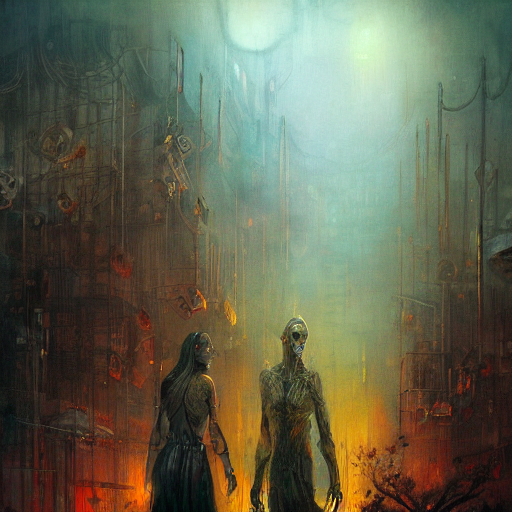

0it [00:00, ?it/s]

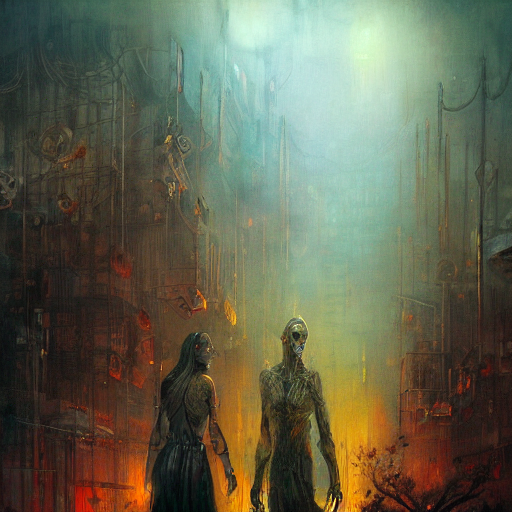

0it [00:00, ?it/s]

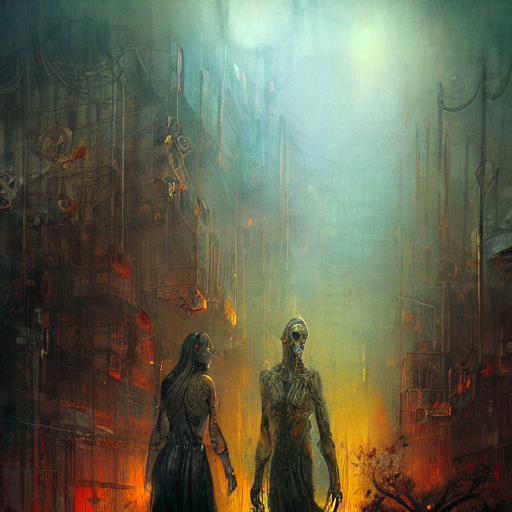

0it [00:00, ?it/s]

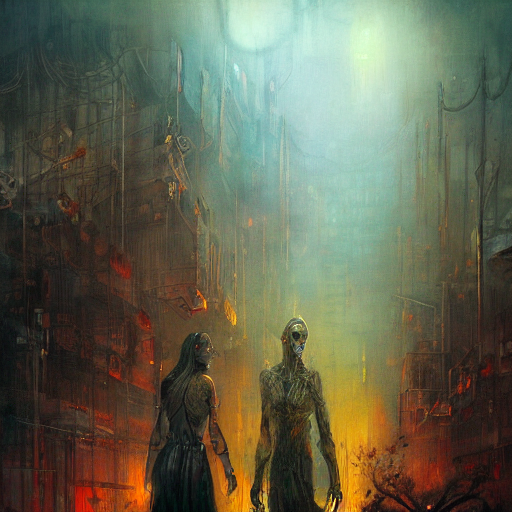

0it [00:00, ?it/s]

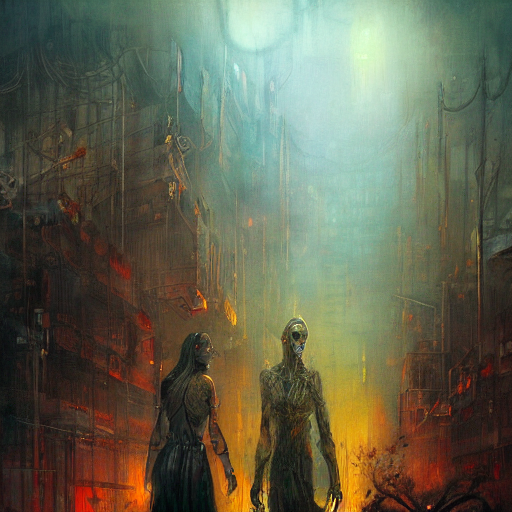

0it [00:00, ?it/s]

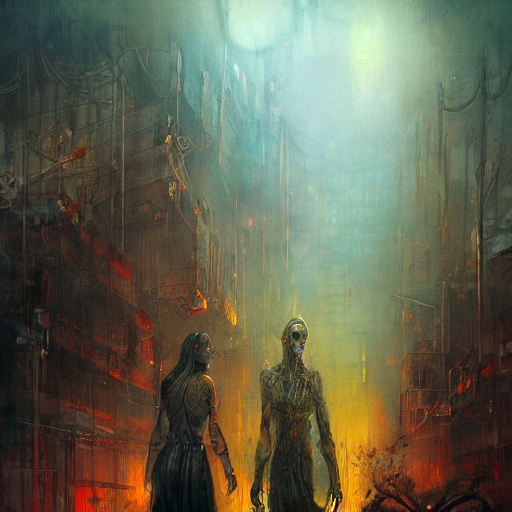

0it [00:00, ?it/s]

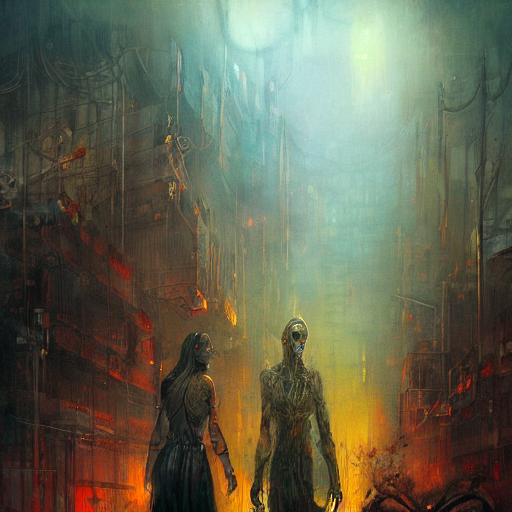

0it [00:00, ?it/s]

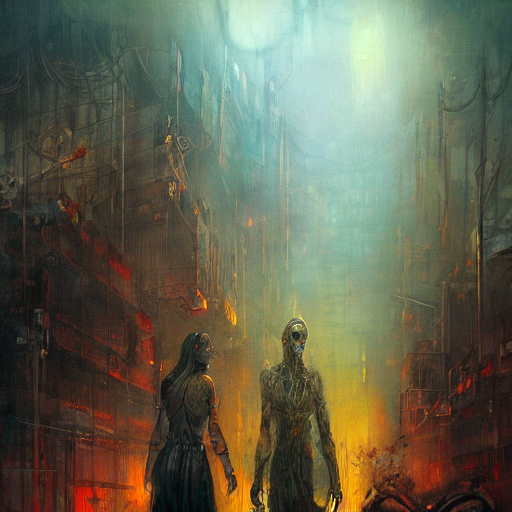

0it [00:00, ?it/s]

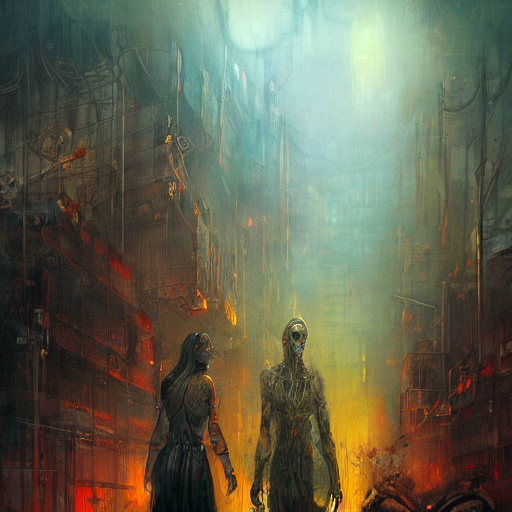

0it [00:00, ?it/s]

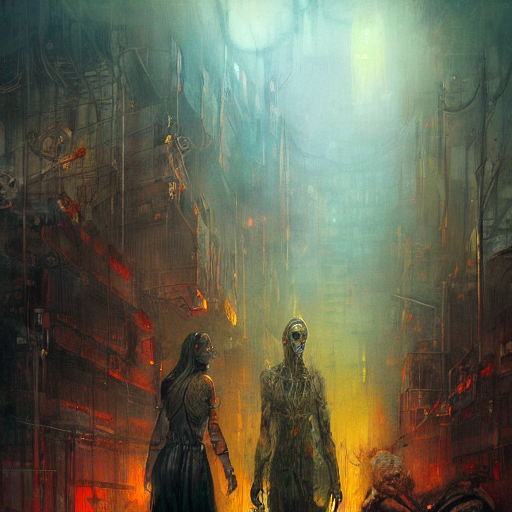

0it [00:00, ?it/s]

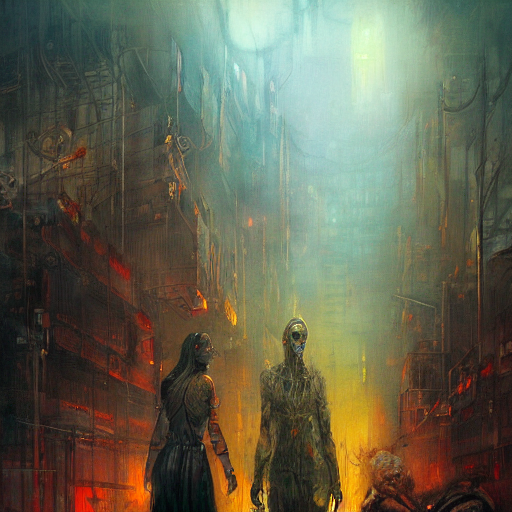

0it [00:00, ?it/s]

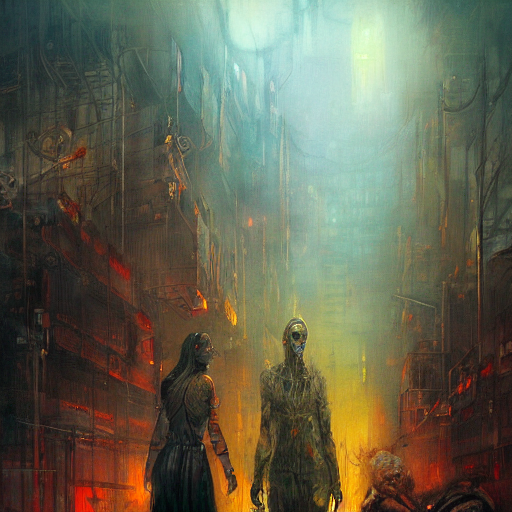

0it [00:00, ?it/s]

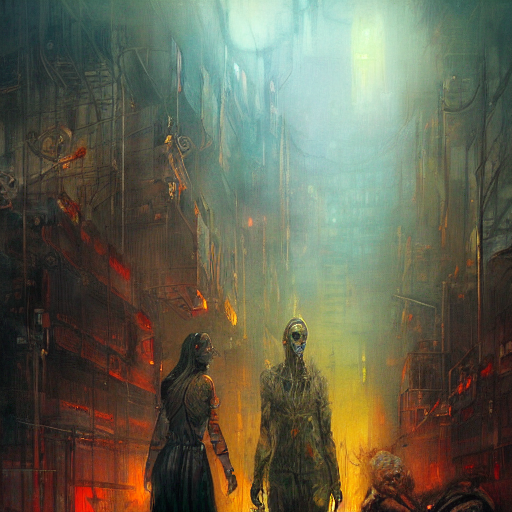

0it [00:00, ?it/s]

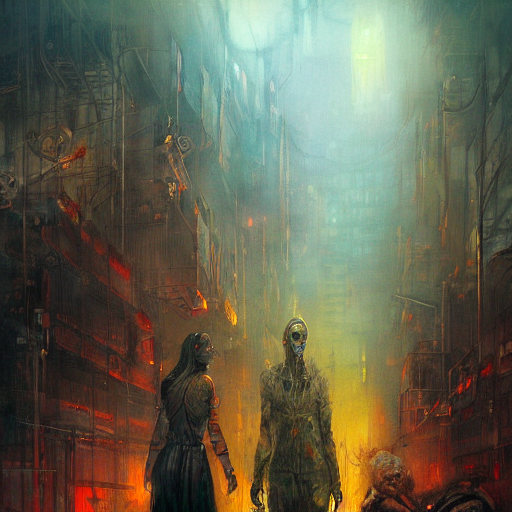

0it [00:00, ?it/s]

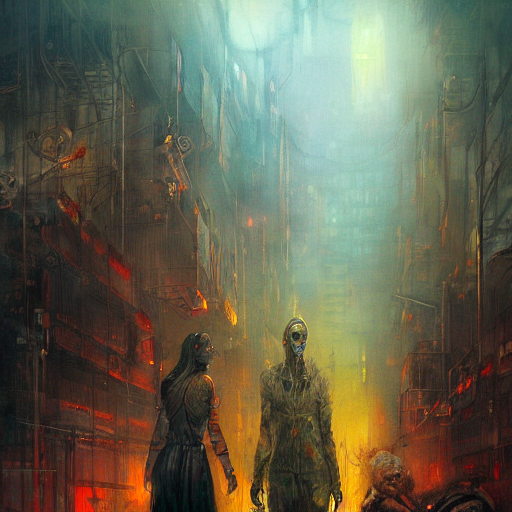

0it [00:00, ?it/s]

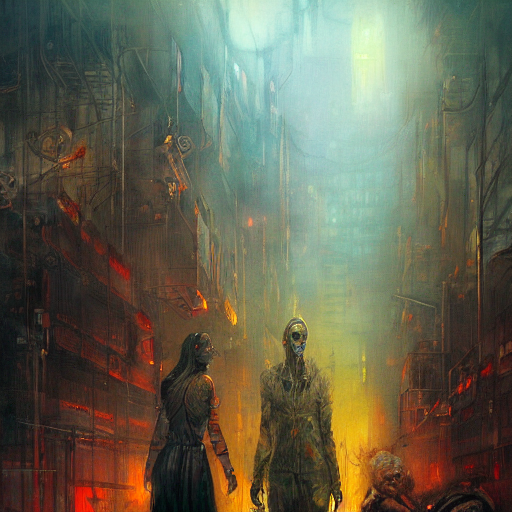

0it [00:00, ?it/s]

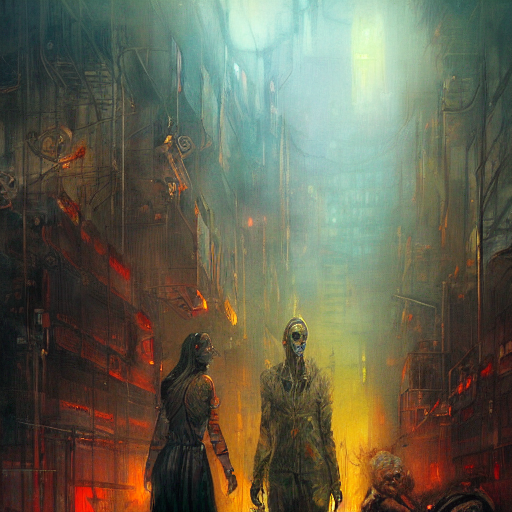

0it [00:00, ?it/s]

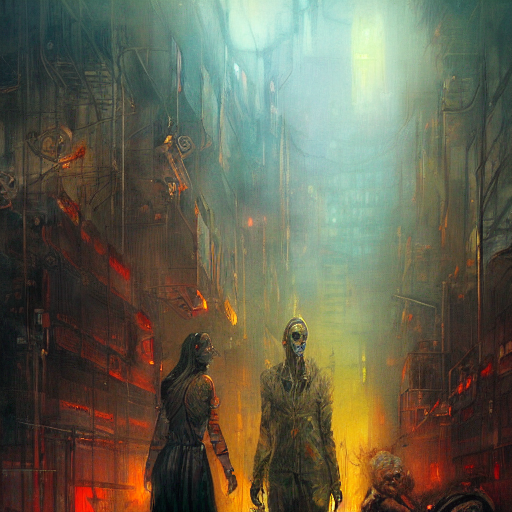

0it [00:00, ?it/s]

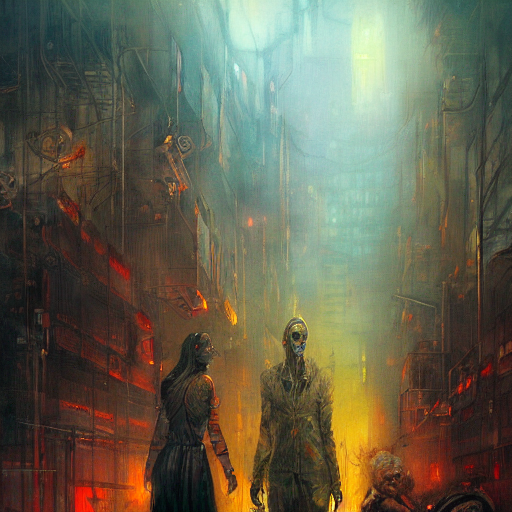

0it [00:00, ?it/s]

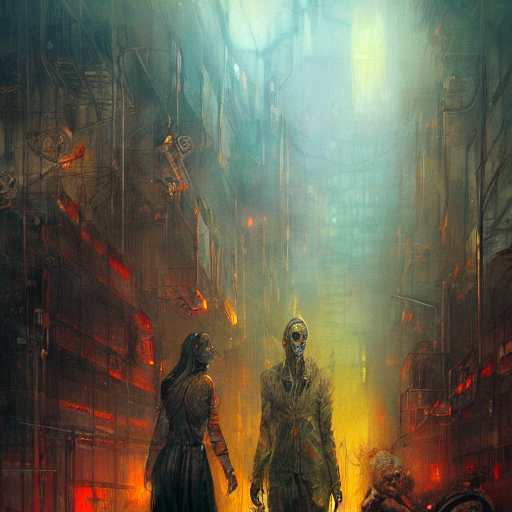

0it [00:00, ?it/s]

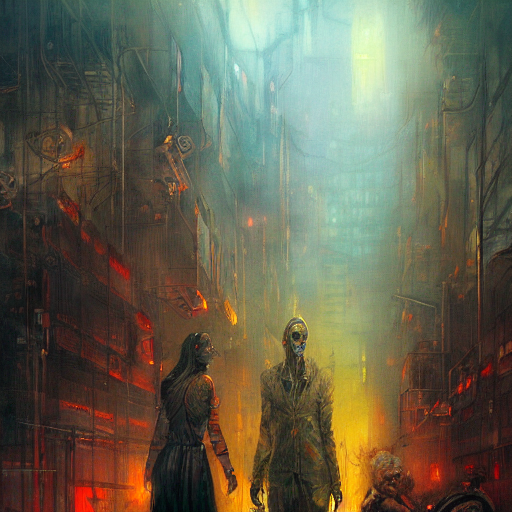

0it [00:00, ?it/s]

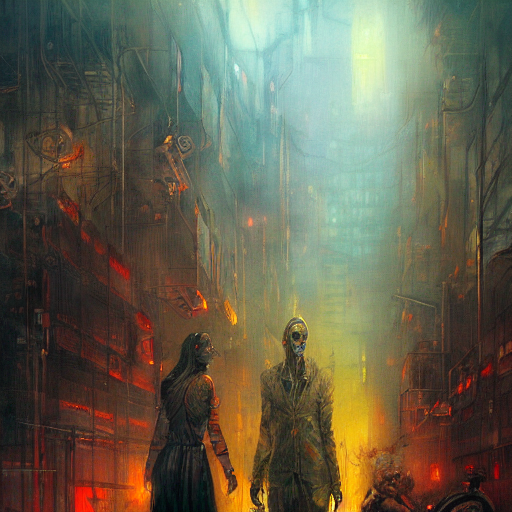

0it [00:00, ?it/s]

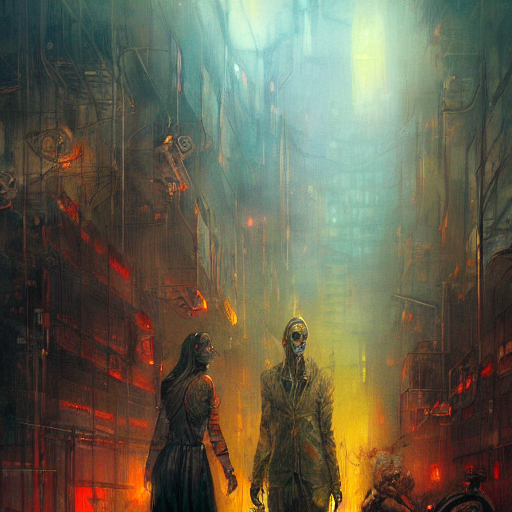

0it [00:00, ?it/s]

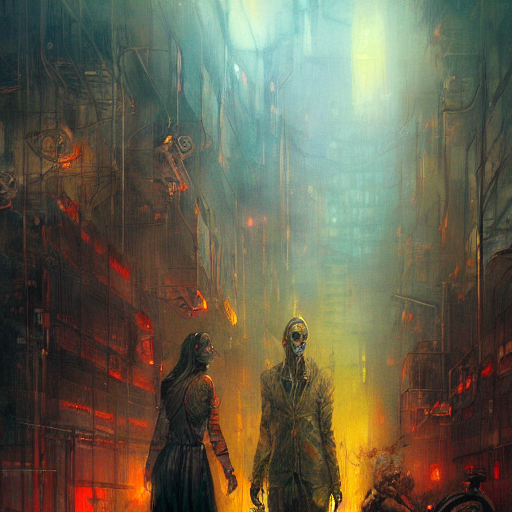

0it [00:00, ?it/s]

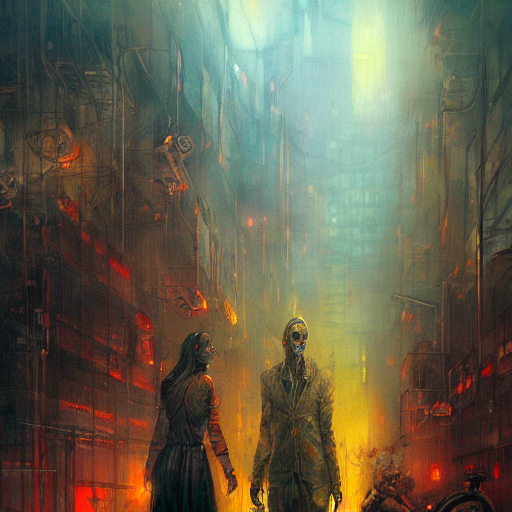

In [ ]:
ims = []
for short in shots:
    i = emb_to_img(short)
    ims.append(i)
    display(i)
    

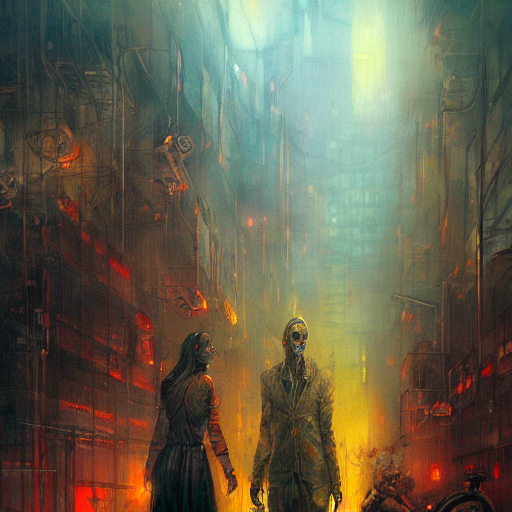

In [ ]:
ims[-1]

In [ ]:
from mytools.tools import *

In [ ]:
to_pickle(ims,'ims')

In [ ]:
import cv2
import numpy as np

In [ ]:
def pil2cv2(img): return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)

In [ ]:
ims_cv2 = [pil2cv2(i) for i in ims]

In [ ]:
height, width, layers =ims_cv2[0].shape

In [ ]:
name = 'shapes'

In [ ]:
video = cv2.VideoWriter(f'{name}.avi', 0, 5, (width,height))

In [ ]:
fps=5

In [ ]:
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# Video Name
randomName = np.random.randint(0,1000)
video = cv2.VideoWriter(f"{name}.mp4", fourcc, fps, (width,height))

In [ ]:
for i in ims_cv2:
    video.write(i)

In [ ]:
import os

def convert_avi_to_mp4(avi_file_path, output_name):
    os.popen("ffmpeg -i '{input}' -ac 2 -b:v 2000k -c:a aac -c:v libx264 -b:a 160k -vprofile high -bf 0 -strict experimental -f mp4 '{output}.mp4'".format(input = avi_file_path, output = output_name))
    return True

In [ ]:
convert_avi_to_mp4(f'{name}.avi',name)

True

ffmpeg version 4.2.7-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.4.0-1ubuntu1~20.04.1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --e